# Test 6: Sampling a multimodal multidimensional distribution
For this test we will sample a 9-dimensional space with 10 embedded normal distribution fuctions centred at random points.


In [1]:

import sys
import numpy as np
from scipy.special import logsumexp

import os

%matplotlib inline
import matplotlib.pyplot as plt

sys.path.append(os.path.abspath('../Code'))
from Adaptive_Sampler import Adaptive_Sampler

from time import time


First we define our log probability function.

In [2]:
# Multimodal gaussian in N dimensions with heights h and centres at c
def ln_prob(p,c,h):
    x = np.array([-np.sum((p-c[:,i])**2)/2.0 for i in range(c.shape[1])])
    return logsumexp(x,b=h)


We will use 10 gaussians and a 9-dimensional space.

In [3]:
ndim = 9
ngauss = 10

# positions
c = 100.0*(np.random.rand(ndim,ngauss)-0.5*np.ones((ndim,ngauss)))
# heights
h = 1.0 + np.random.rand(ngauss)

print('c:', c)
print('h:',h)
print('ln_prob:',[ln_prob(c[:,i],c,h) for i in range(ngauss)])



c: [[ -2.33435349 -21.56853255  21.28937654 -14.60402412  31.16890526
   -5.55596286  42.35729228 -49.39279953 -18.70295205 -32.98336246]
 [ -1.56584403  36.35799335  14.63626834 -32.06262978  39.91642727
  -19.17987309   2.43415044 -24.82373369   3.71998541 -14.84426657]
 [-38.72238318   0.32042227 -11.10565792 -11.5631314  -26.69686745
  -18.36431018  20.14804461 -32.19936056  25.29094114  10.02152204]
 [ 11.00857211  37.41139534  21.38905659  -1.36612881  37.46002089
   17.99039     45.38795074 -16.49262236  25.14935401 -34.37288709]
 [-35.60357647  25.6915646  -34.59951725 -20.70551442  44.75321419
   -3.9077733  -12.76651223  30.75969837 -35.18100467  11.03530705]
 [ -5.03567233  13.38363954 -46.69233114  37.34423561 -33.14907587
   40.00296532  23.77922139   3.60087791 -16.97835049  41.37228984]
 [-24.08325711  34.49256474  39.85085799   7.91585861 -25.63270855
   39.81598493 -46.52859065 -33.76823509 -32.73993638 -11.42330902]
 [ 37.11263896  46.23978068 -22.94875447 -41.3704148

We will employ 200 independent Markov chains. For our starting guesses, we distibute each chain randomly through the parameter space. (This is the preferred way to operate when using chains as independent samplers.)

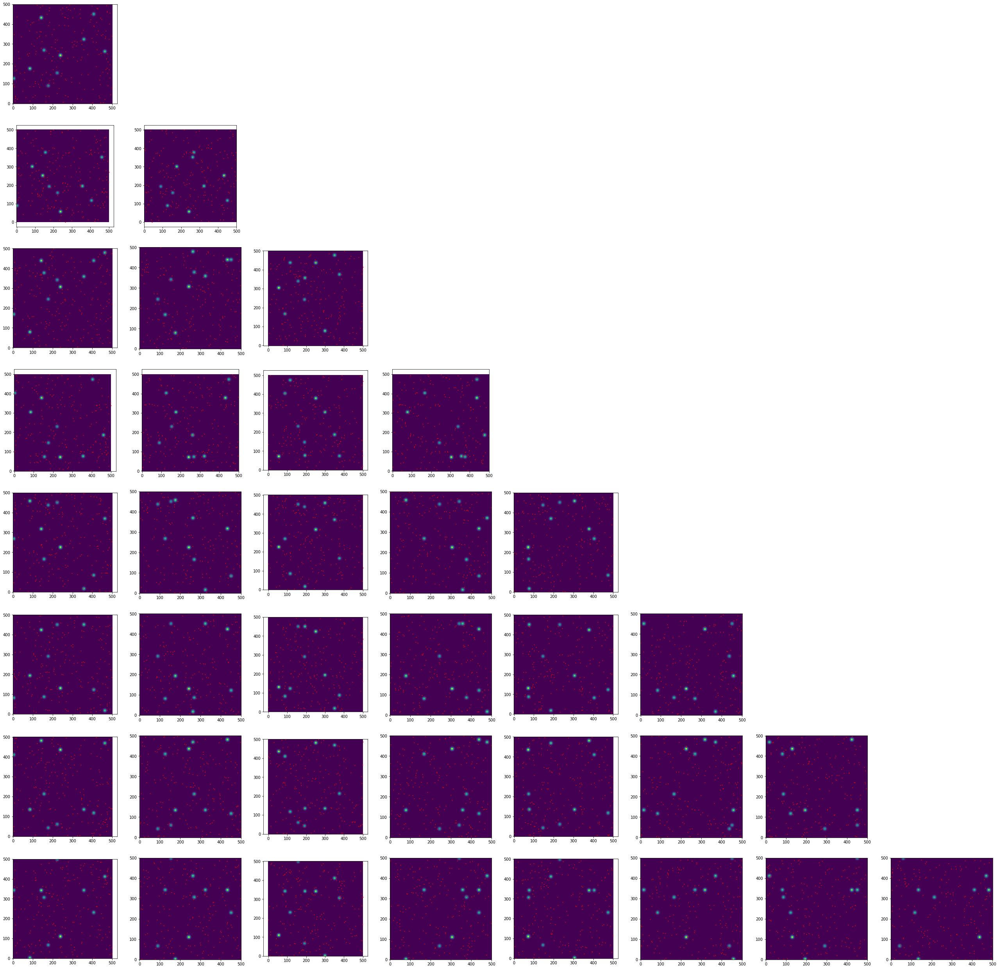

In [27]:
#
#  Starting guesses
#
p_guess = np.zeros(ndim)

nchains = 200

start = np.empty((nchains,ndim))

for chain in range(nchains):
    start[chain] = p_guess + 100.0 * np.random.rand(ndim) - 50


#
# Make images of the projected probability distributions with starting chain positions
# overplotted in red.
#

x = np.linspace(-50.0,50.0,501)
y = np.linspace(-50.0,50.0,501)
X,Y = np.meshgrid(x,y)

figsize=(5*ndim,5*ndim)
plt.figure(figsize=figsize)

for j in range(1,ndim):
    for k in range(j):
        
        plt.subplot(ndim-1,ndim-1,k+(j-1)*(ndim-1)+1)
        
        Z = np.zeros((501,501))
        for i in range(ngauss):
            Z += h[i]*np.exp(-((X-c[k,i])**2 + (Y-c[j,i])**2)/2.0)

        plt.imshow(Z,origin='lower')

        plt.scatter((start[:,k]+50)*500/100,(start[:,j]+50)*500/100,c='r',s=1) 


Now we sample this space using simulated annealing. We gradually reduce the "temperature" by a factor of 100 during the burnin. Each chain has its own covariance matrix, and consequently its own adaptive proposal distibution. This part takes about a half hour on my macbook pro.


alpha: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1.]

alpha: [1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1
 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1
 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1
 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1
 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1
 1.1 1.1 

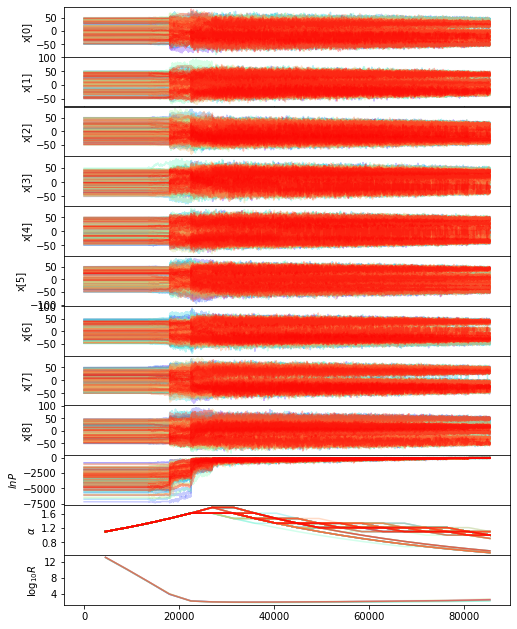

In [28]:
nsteps = ndim*500
temperature = 100
iterations = 20
delta_T = temperature/(nsteps*iterations)


sampler = Adaptive_Sampler(ndim=ndim,nchains=nchains,ln_prob_fn=ln_prob,initial_temperature=temperature,sigma=0.000001*np.ones(ndim),args=(c,h))

#
# Note that we use individual chain covariances so cannot use the GR convergence test
#
t0 = time()
for i in range(iterations):
    sampler.iterate_chains(nsteps,start=start,scale_individual_chains=True,temperature_change_rate=delta_T)
    print()
    print('alpha:',sampler.alpha)

print('time taken', time()-t0)
sampler.plot_chains(plot_to_file=False)




We now do a shorter post-burnin production run and make plot of the samples projected onto each set of 2 dimensions using Dan Foreman-Mackey's wonderful ${\bf \it corner}$ code. 

parameter means and uncertainties:
[(-14.060741785171459, 37.55053869703455, 18.06021912945745), (1.4032972355005375, 34.829293654302234, 21.475203791646436), (-10.896775371933721, 33.96962433813489, 22.844212264731603), (21.266884138085757, 15.876200537634809, 35.482610534118834), (-18.531683768162768, 48.21119634354615, 17.17909879938203), (-2.826327141652173, 41.90083995772827, 31.225402137458786), (-22.132958617935852, 60.278476024225895, 11.075350660297278), (-10.062256716048157, 49.92750310274681, 20.511742280027114), (10.670584199787584, 9.21682755755391, 46.427844228082996)]


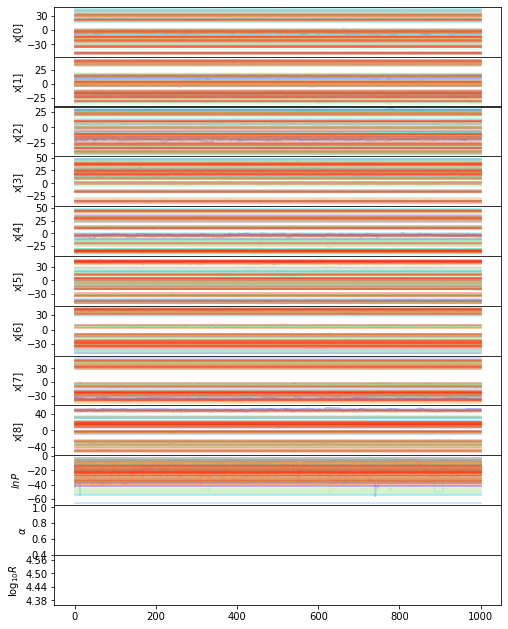

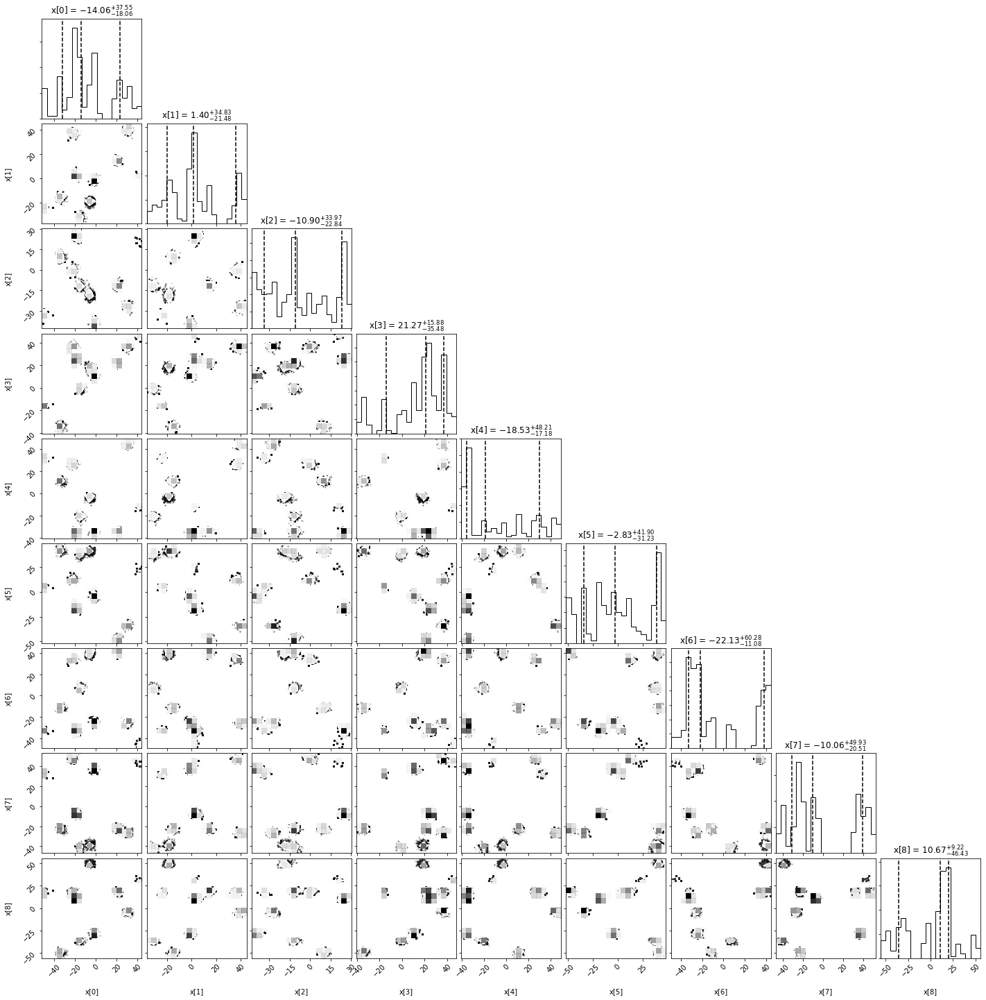

In [30]:

nsteps = 1000
sampler.reset()

sampler.iterate_chains(nsteps,scale_individual_chains=True)

params = list(map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]), \
            zip(*np.percentile(sampler.chains[-nsteps:,:,:].reshape(nsteps*nchains,ndim), \
            [16, 50, 84], axis=0))))

print('parameter means and uncertainties:')
print(params)

sampler.plot_chains(plot_to_file=False)

sampler.plot_chain_corner(nsteps=nsteps,corner_kwargs={"plot_contours":False})




The chains seem to have done a good job of migrating to the gaussian positions. To detect the individual solutions we can use the DBSCAN algorithm implemented in scikit-learn. We won't necessarily have detected all the orginal maxima. The detection of clusters of points in what follows is somewhat sensitive to the DBSCAN parameters. If you are detecting too many/few clusters, try changing min_samples to be bigger/smaller.

Estimated number of clusters: 20
Estimated number of noise points: 85456
labels {0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, -1}
0 [ 21.37053904  15.61866402 -12.39804955  21.96437734 -34.51909203
 -47.93997701  40.36433159 -22.49502774  19.16976469]
1 [ -2.12810286  -1.50527854 -39.53459989  10.82076069 -35.31390037
  -4.43336127 -23.73490655  36.59997241 -28.56518937]
2 [-14.61853695 -31.01485772 -10.5227464   -0.30322739 -20.66447999
  38.85306725   6.87044153 -41.06535551 -36.32488323]
3 [-18.83400645   2.98936203  24.48078344  25.0818529  -35.09324253
 -17.37714977 -33.12464935  -8.06691041  11.00140729]
4 [ -5.42535568 -18.56417694 -17.19646978  17.60178735  -4.42345456
  41.08981952  40.51709958 -39.14124187  49.17912566]
5 [-34.2464347  -12.61709935   9.50619234 -37.30286032  11.12875398
  36.86442891 -13.06314064 -21.85222543 -50.18851975]
6 [-33.68088851 -13.68540842  12.34419697 -34.93773416   8.84736851
  42.08789473 -10.88520204 -22.51936245 -49.0

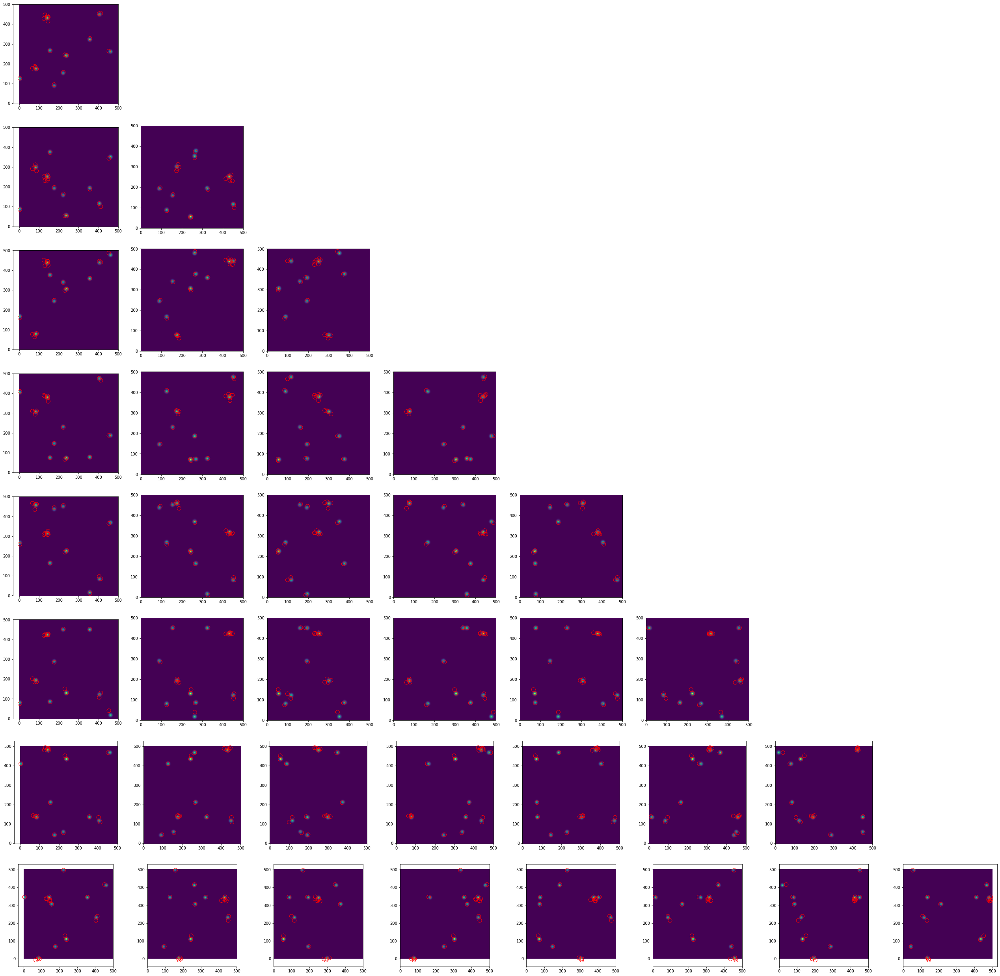

In [35]:
from sklearn.cluster import DBSCAN
from sklearn import metrics

samples = sampler.chains.reshape((nsteps+1)*nchains,ndim)

db = DBSCAN(eps=5,min_samples=nsteps*nchains/100).fit(samples)

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
n_noise = list(labels).count(-1)

print('Estimated number of clusters: %d' % n_clusters)
print('Estimated number of noise points: %d' % n_noise)
#print("Silhouette Coefficient: %0.3f"
#      % metrics.silhouette_score(samples, labels))

print('labels',set(labels))

cluster_centers = np.empty((n_clusters,ndim))

for k in range(n_clusters):
    class_member_mask = (labels == k)
    cluster_samples = samples[class_member_mask & core_samples_mask]
    cluster_centers[k] = np.median(cluster_samples,axis=0)
    print(k,cluster_centers[k])

plt.figure(figsize=figsize)

# Repeat the probability figures, with overplotted cluster centres
for j in range(1,ndim):
    for k in range(j):
        
        plt.subplot(ndim-1,ndim-1,k+(j-1)*(ndim-1)+1)
        
        Z = np.zeros((501,501))
        for i in range(ngauss):
            Z += h[i]*np.exp(-((X-c[k,i])**2 + (Y-c[j,i])**2)/2.0)

        plt.imshow(Z,origin='lower')

        plt.scatter((cluster_centers[:,k]+50)*500/100,(cluster_centers[:,j]+50)*500/100,facecolors='none', edgecolors='r',s=100) 



We seem to have done a good job of detecting most (if not all) of the original maxima, sometimes with more than one recognised cluster of points. Now we run new samplers for each detected solution, using a small number of chains and scaling our covariance matrix from the ensemble. Having a few too many detected clusters is OK since neighbouring ones will usually converge to the same solution.

1
R: [100. 100. 100. 100. 100. 100. 100. 100. 100.]
alpha: [1. 1. 1. 1. 1. 1. 1. 1.]

2001
R: [ 88.33020358  86.14255105  51.57043734  57.65520178  70.27650774
 101.3522654   74.9051474  101.49825866  70.13110946]
alpha: [1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1]

4001
R: [7.0046943  4.76309856 4.15175961 6.5349712  5.58985547 5.06600142
 5.50473842 4.07425159 3.6169038 ]
alpha: [1.21 1.21 1.21 1.21 1.21 1.21 1.21 1.21]

6001
R: [1.17061284 1.16804802 1.15679929 1.15558336 1.16382059 1.17311407
 1.16251886 1.15457702 1.16334415]
alpha: [1.21 1.21 1.21 1.21 1.21 1.21 1.21 1.21]

8001
R: [1.13346183 1.14258978 1.14020617 1.13874311 1.14616372 1.13097266
 1.1378634  1.16621349 1.15359124]
alpha: [1.21 1.21 1.21 1.21 1.21 1.21 1.21 1.21]

10001
R: [1.15363902 1.14288066 1.15493952 1.14231702 1.14394473 1.14285287
 1.14523795 1.15540001 1.15969698]
alpha: [1.21 1.21 1.21 1.21 1.21 1.21 1.21 1.21]

12001
R: [1.12281854 1.11080211 1.12344325 1.11719671 1.12902225 1.14198259
 1.12748484 1.12834245 1.12

/Users/mda45/Projects/Adaptive_Sampler/Code/Adaptive_Sampler.py:341: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(8,11))



solution 10
parameter means and uncertainties:
[(42.479286430065265, 0.9589305553392364, 1.0538700696375614), (2.352995557242556, 0.9618177354701967, 0.9674832280032644), (20.158904991498304, 0.9958429254228847, 0.9930046582401744), (45.37801774085499, 1.0418221985241942, 1.0124680720739647), (-12.828624893096167, 0.9596228545016796, 0.9842885559206813), (23.769520057923692, 1.0145582552434185, 0.9398795714540427), (-46.50742622826977, 0.9439182614660098, 1.0211589384236532), (43.732310287683596, 0.9841133298841811, 0.917129109932965), (32.282460944479126, 0.9153400755895902, 0.994308620173161)]



//anaconda/envs/python3/lib/python3.6/site-packages/corner/corner.py:207: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = pl.subplots(K, K, figsize=(dim, dim))


1
R: [100. 100. 100. 100. 100. 100. 100. 100. 100.]
alpha: [1. 1. 1. 1. 1. 1. 1. 1.]

2001
R: [ 41.01189601  77.67596114 101.18471098  63.9303108   74.50835789
  60.65898983  80.16451406  72.67743613  58.26748549]
alpha: [1.1 1.1 1.1 1.1 1.1 1.1 1.1 1.1]

4001
R: [4.24509267 8.57486264 2.89532974 6.53317145 5.85023382 5.84934705
 5.21161768 5.53674726 5.08623078]
alpha: [1.21 1.21 1.21 1.21 1.21 1.21 1.21 1.21]

6001
R: [1.17906468 1.16163609 1.17545754 1.17757647 1.16321334 1.19685369
 1.17530532 1.18465692 1.19027759]
alpha: [1.21 1.21 1.21 1.21 1.21 1.21 1.21 1.21]

8001
R: [1.1388109  1.12657671 1.12914433 1.13202262 1.13499639 1.1357411
 1.13739796 1.13348304 1.14418997]
alpha: [1.21 1.21 1.21 1.21 1.21 1.21 1.21 1.21]

10001
R: [1.13470587 1.12046549 1.12507891 1.12317642 1.1351001  1.12210192
 1.12077324 1.13437851 1.12751865]
alpha: [1.21 1.21 1.21 1.21 1.21 1.21 1.21 1.21]

12001
R: [1.10725091 1.1134436  1.10308363 1.10866562 1.11419283 1.11365142
 1.10548853 1.10708216 1.102

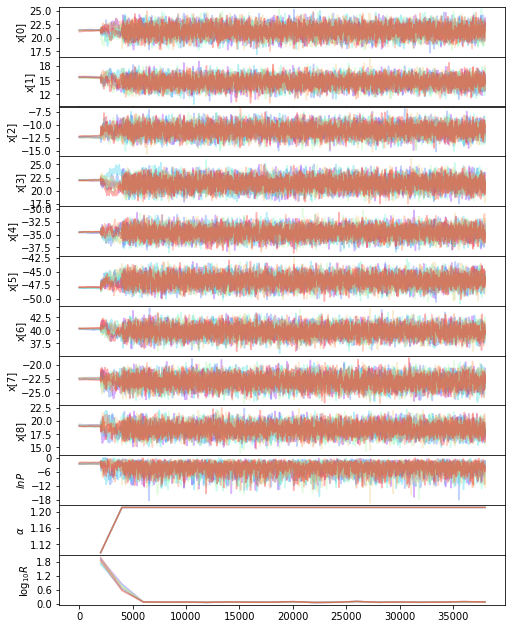

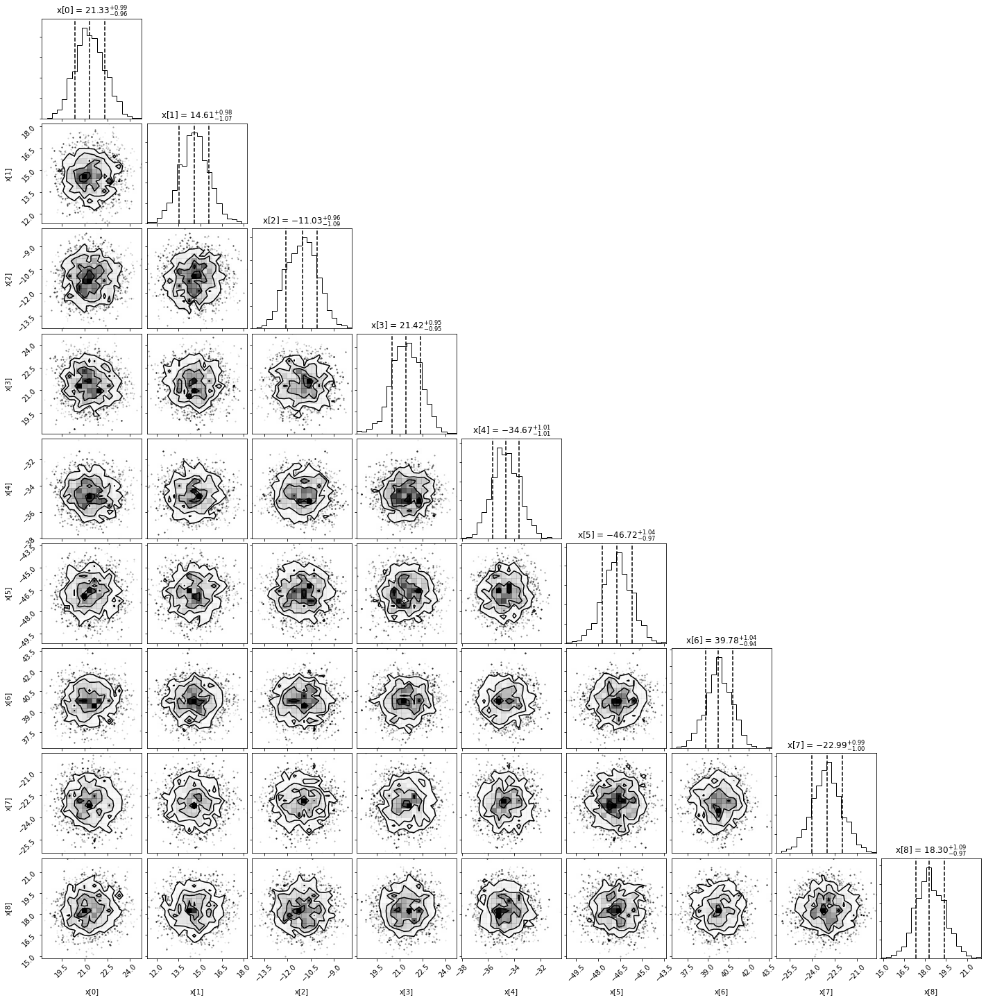

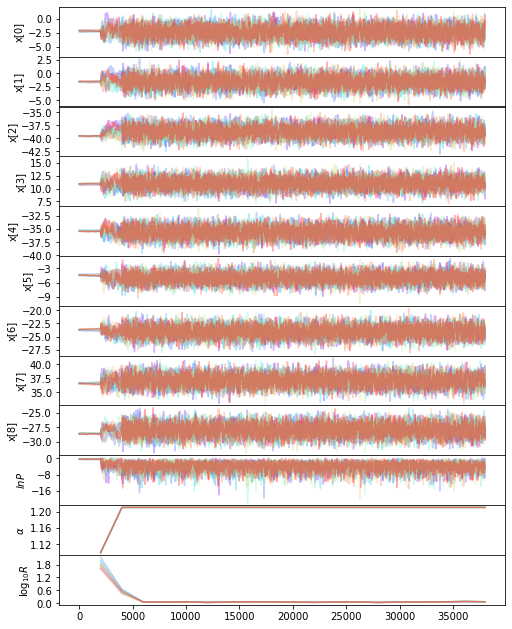

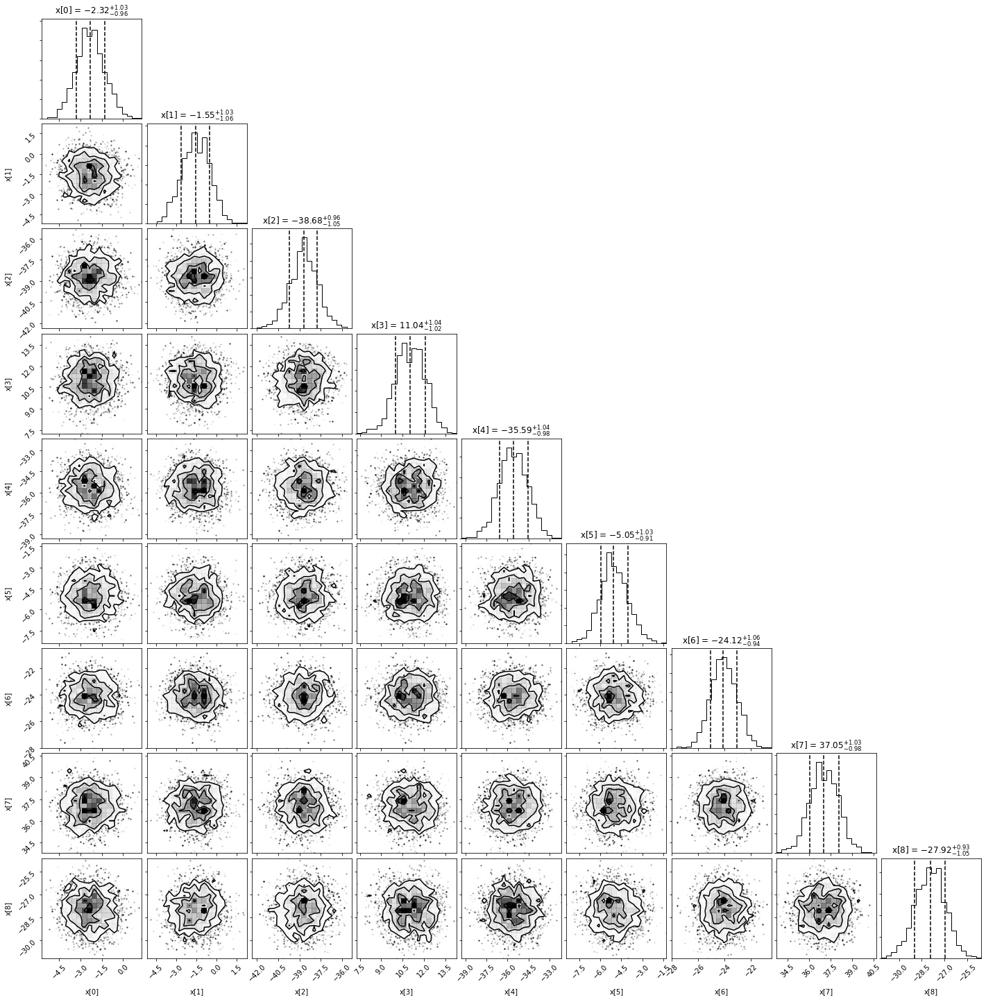

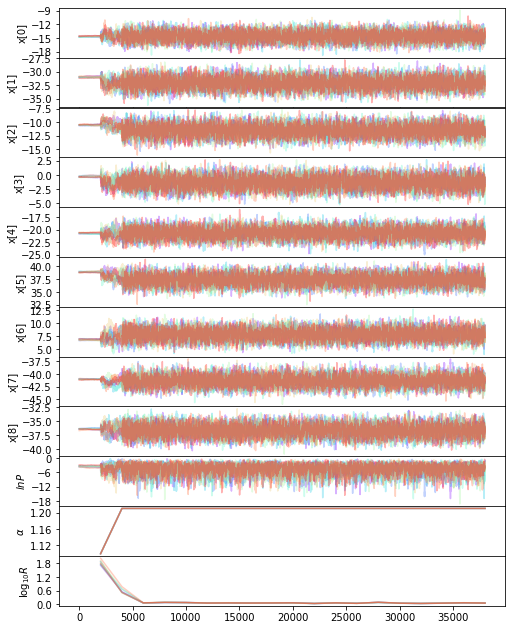

...

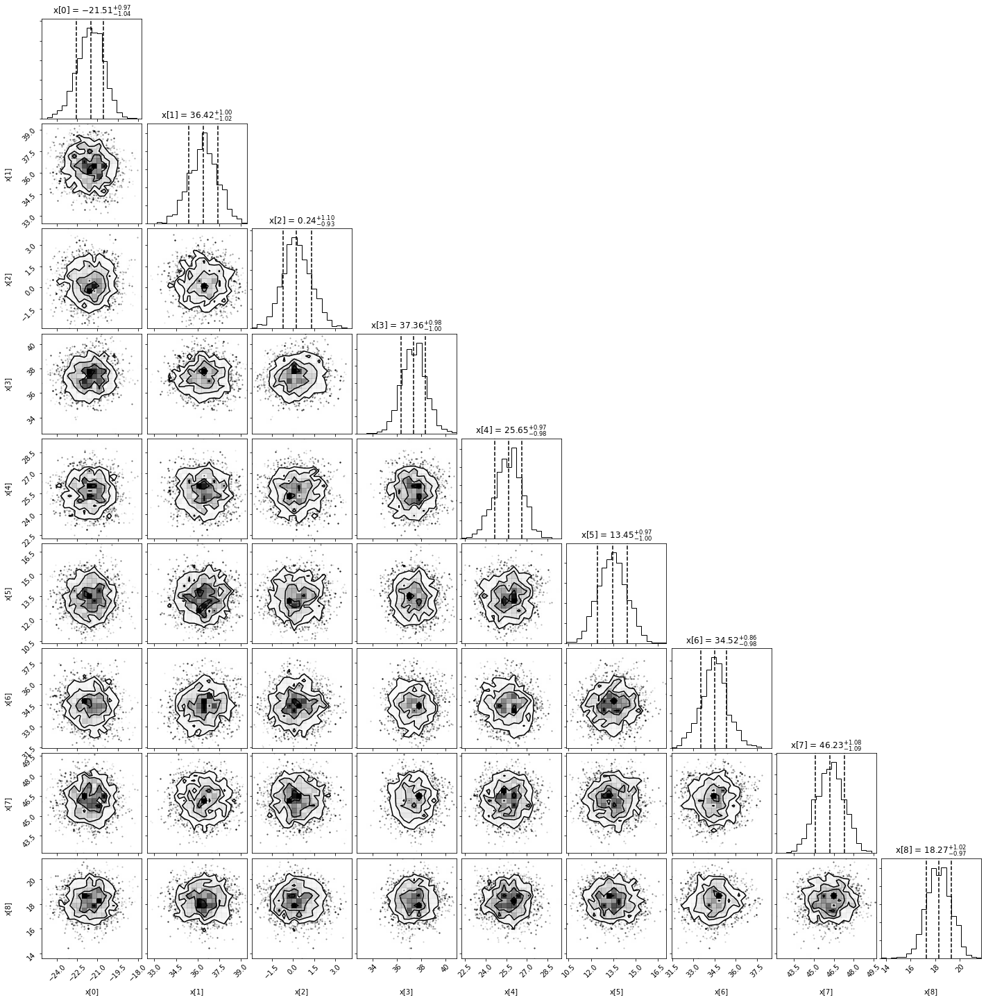

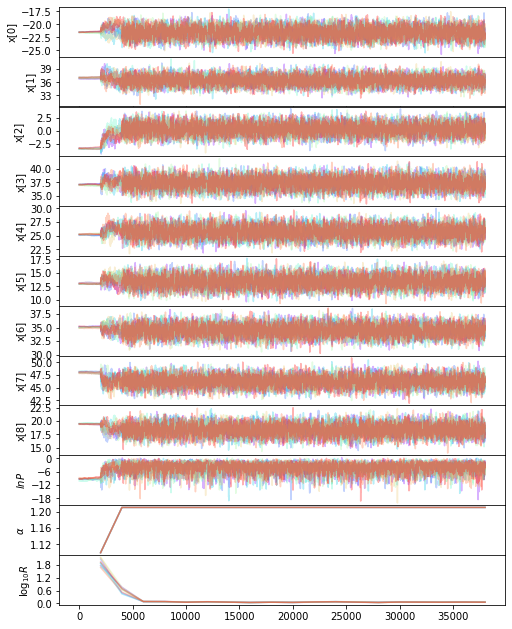

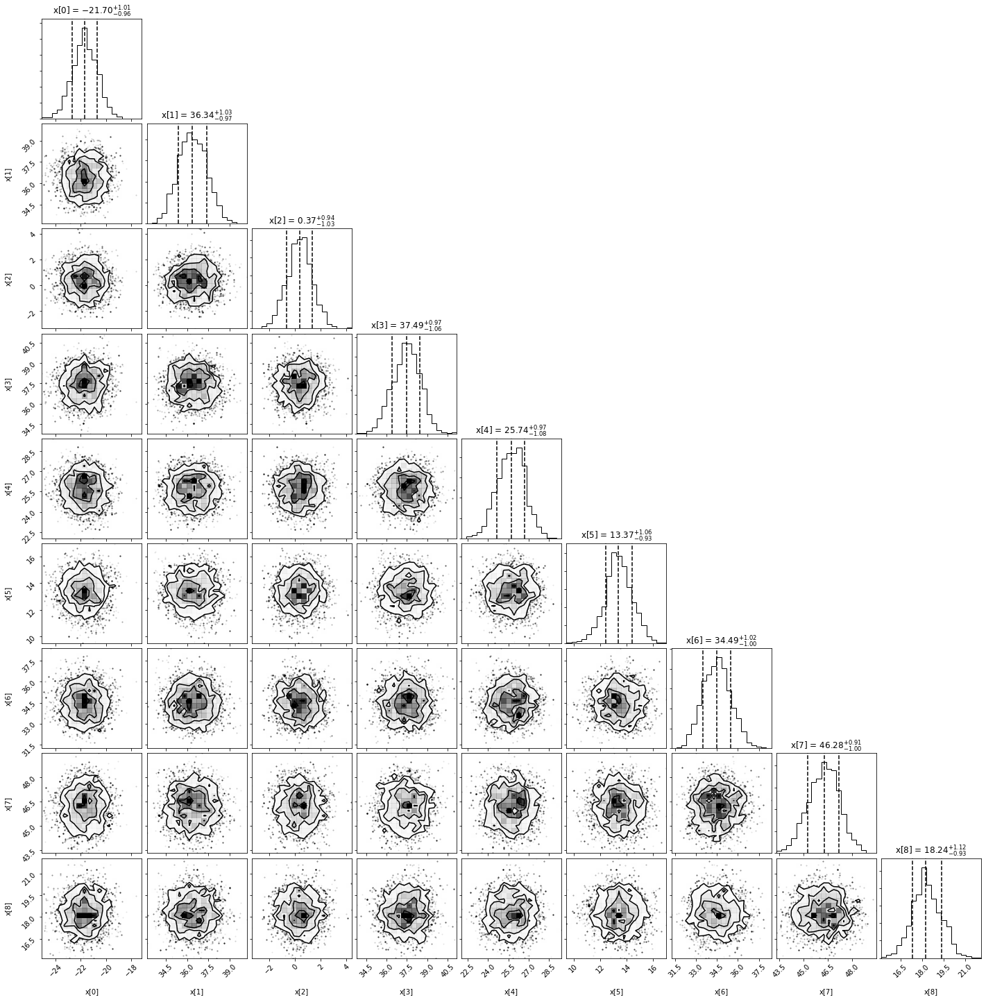

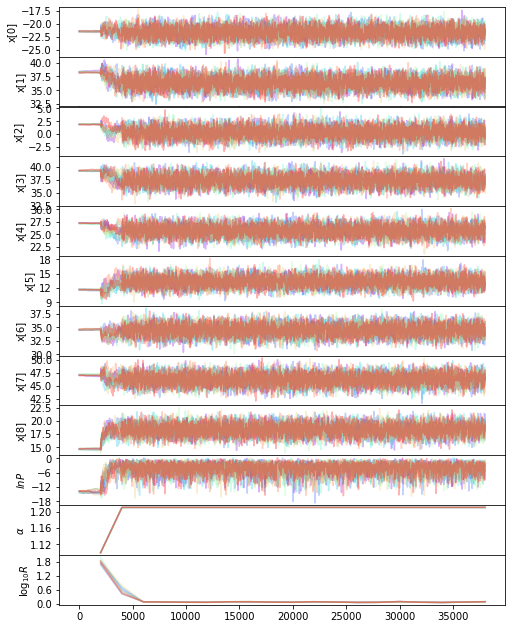

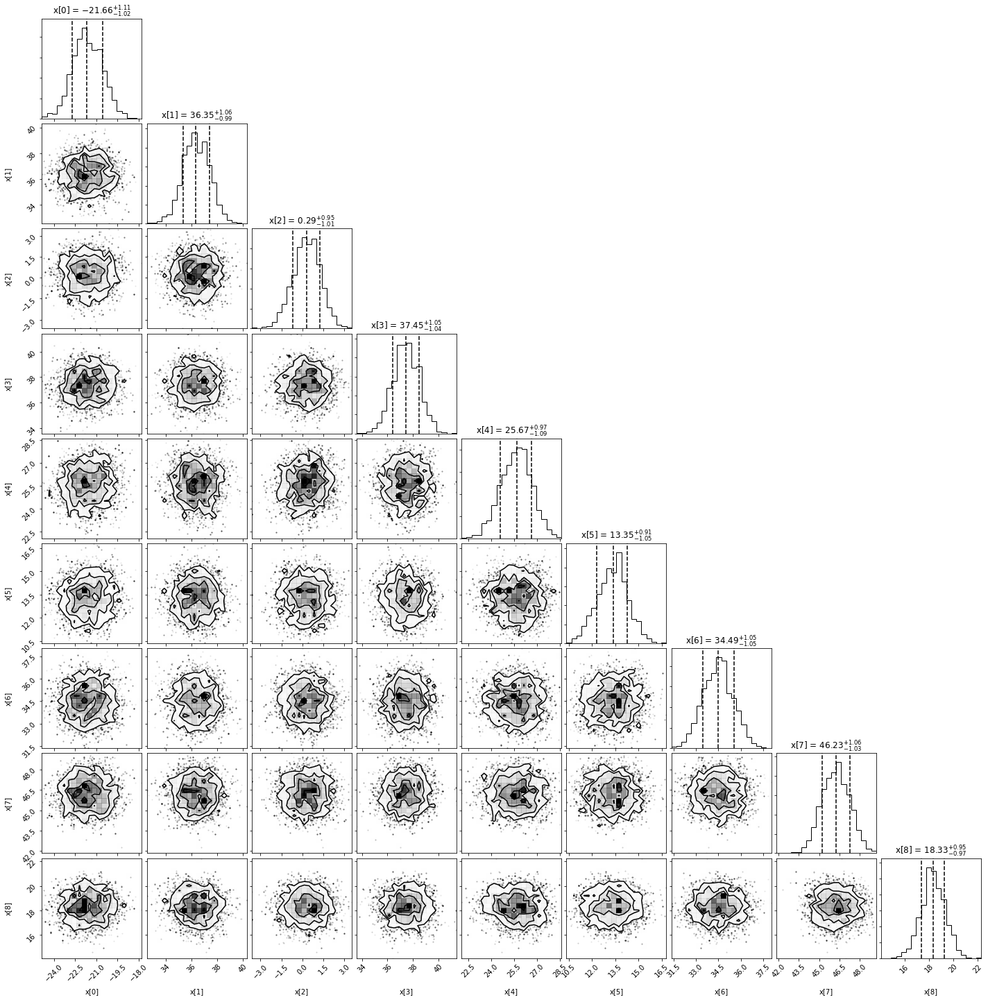

In [36]:
nchains1 = 8
nburnin = 2000
nsteps = 2000

cluster_medians = np.empty((n_clusters,ndim))

for i in range(n_clusters):
    
    sampler1 = Adaptive_Sampler(ndim=ndim,nchains=nchains1,ln_prob_fn=ln_prob,sigma=0.002*np.ones(ndim),args=(c,h))

    nit = 0
    while np.max(sampler.R) > 1.1 and nit < 20:
        sampler1.iterate_chains(nburnin,start=cluster_centers[i],plot_progress=False,scale_individual_chains=False)
        nit += 1
        print(sampler1.iterations)
        print('R:', sampler1.R)
        print('alpha:', sampler1.alpha)
        print()

    sampler1.plot_chains(plot_to_file=False)

    sampler1.reset()

    sampler1.iterate_chains(nsteps,scale_individual_chains=False)

    params = list(map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]), \
                zip(*np.percentile(sampler1.chains[-nsteps:,:,:].reshape(nsteps*nchains1,ndim), \
                [16, 50, 84], axis=0))))

    print()
    print('solution',i)    
    print('parameter means and uncertainties:')
    print(params)
    print()

    cluster_medians[i] = np.array([s[0] for s in params])
    
    sampler1.plot_chain_corner(nsteps=nsteps,plot_to_file=False)



These look pretty good. How close did we get to our true solutions?

In [37]:
ct = c.T

for i in range(n_clusters):
    
    best = np.argmin(np.sum((ct-cluster_medians[i])**2,axis=1))
    print('solution',i,'matches gaussian',best)
    print('ct[%d]'%best,ct[best])
    print('cluster_medians[%d]'%i,cluster_medians[i])
    print('residuals:', ct[best] - cluster_medians[i])
    print()


solution 0 matches gaussian 2
ct[2] [ 21.28937654  14.63626834 -11.10565792  21.38905659 -34.59951725
 -46.69233114  39.85085799 -22.94875447  18.43368455]
cluster_medians[0] [ 21.33226722  14.60811664 -11.03261921  21.42431678 -34.66589708
 -46.71674527  39.77514777 -22.9897087   18.29767864]
residuals: [-0.04289069  0.02815171 -0.07303871 -0.03526019  0.06637983  0.02441413
  0.07571022  0.04095424  0.13600591]

solution 1 matches gaussian 0
ct[0] [ -2.33435349  -1.56584403 -38.72238318  11.00857211 -35.60357647
  -5.03567233 -24.08325711  37.11263896 -27.95407646]
cluster_medians[1] [ -2.3241866   -1.54644057 -38.68323507  11.03745634 -35.59111888
  -5.05089914 -24.12456197  37.04996873 -27.91833961]
residuals: [-0.01016688 -0.01940346 -0.0391481  -0.02888424 -0.01245759  0.0152268
  0.04130486  0.06267023 -0.03573685]

solution 2 matches gaussian 3
ct[3] [-14.60402412 -32.06262978 -11.5631314   -1.36612881 -20.70551442
  37.34423561   7.91585861 -41.37041485 -36.64833576]
cluster_m

Let's try emcee with the same problem. We will run it using the same number of walkers as we had chains, the same starting points, and the same number of burnin and production steps.

In [14]:
import emcee
import corner

nwalkers = nchains

esampler = emcee.EnsembleSampler(nwalkers, ndim, ln_prob, args=(c,h))


In [15]:

emcee_start = [start[i].tolist() for i in range(nchains)]

t0 = time()

state, lnp , _ = esampler.run_mcmc(start, 20*500*ndim)

print('time', time()-t0)


time 1697.071729183197


In [17]:
esampler.reset()

state, lnp , _ = esampler.run_mcmc(start, 1000)


In [ ]:
# Repeat the probability figures for comparison with the emcee samples.
plt.figure(figsize=figsize)

for j in range(1,ndim):
    for k in range(j):
        
        plt.subplot(ndim-1,ndim-1,k+(j-1)*(ndim-1)+1)
        
        Z = np.zeros((501,501))
        for i in range(ngauss):
            Z += h[i]*np.exp(-((X-c[k,i])**2 + (Y-c[j,i])**2)/2.0)

        plt.imshow(Z,origin='lower')

fig = corner.corner(esampler.flatchain,quantiles=[0.16, 0.5, 0.84],show_titles=True, plot_contours=False,title_args={"fontsize": 12})

